<a href="https://colab.research.google.com/github/Ronphrey/TDI/blob/main/corrected_week11ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("austinreese/craigslist-carstrucks-data")

print("Path to dataset files:", path)

Path to dataset files: /root/.cache/kagglehub/datasets/austinreese/craigslist-carstrucks-data/versions/10


In [2]:
# Imports
import os
import re
import numpy as np
import pandas as pd
import sklearn as sk
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from scipy.stats import ttest_ind , mannwhitneyu , shapiro
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from scipy import stats
from sklearn.preprocessing import MinMaxScaler,Normalizer, Binarizer, StandardScaler

In [3]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 100)
df = pd.read_csv(os.path.join(path, 'vehicles.csv'))

df.head()

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,image_url,description,county,state,lat,long,posting_date
0,7222695916,https://prescott.craigslist.org/cto/d/prescott-2010-ford-ranger/7222695916.html,prescott,https://prescott.craigslist.org,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az,NaN,NaN,NaN
1,7218891961,https://fayar.craigslist.org/ctd/d/bentonville-2017-hyundai-elantra-se/7218891961.html,fayetteville,https://fayar.craigslist.org,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar,NaN,NaN,NaN
2,7221797935,https://keys.craigslist.org/cto/d/summerland-key-2005-excursion/7221797935.html,florida keys,https://keys.craigslist.org,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl,NaN,NaN,NaN
3,7222270760,https://worcester.craigslist.org/cto/d/west-brookfield-2002-honda-odyssey-ex/7222270760.html,worcester / central MA,https://worcester.craigslist.org,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma,NaN,NaN,NaN
4,7210384030,https://greensboro.craigslist.org/cto/d/trinity-1965-chevrolet-truck/7210384030.html,greensboro,https://greensboro.craigslist.org,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc,NaN,NaN,NaN


In [4]:
df.shape

(426880, 26)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 26 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   url           426880 non-null  object 
 2   region        426880 non-null  object 
 3   region_url    426880 non-null  object 
 4   price         426880 non-null  int64  
 5   year          425675 non-null  float64
 6   manufacturer  409234 non-null  object 
 7   model         421603 non-null  object 
 8   condition     252776 non-null  object 
 9   cylinders     249202 non-null  object 
 10  fuel          423867 non-null  object 
 11  odometer      422480 non-null  float64
 12  title_status  418638 non-null  object 
 13  transmission  424324 non-null  object 
 14  VIN           265838 non-null  object 
 15  drive         296313 non-null  object 
 16  size          120519 non-null  object 
 17  type          334022 non-null  object 
 18  pain

#Section A: Data Type Conversion

## 1.Convert data to the correct data types: Inspect the dataset and convert all columns to the appropriate data type (e.g., numerical, categorical, date). Give a summary of your results and the procedures you followed to confirm that the data types were proper.

## 2.Some dataset fields (e.g., URLs, IDs, and other metadata) may not be useful for analysis or modeling. Your goal is to find and delete columns that do not provide useful information for predicting the target variable ('price').


### I used the data information from kaggle's site to cross check the data types of the individual columns. The incorect data types are:

year, county , posting date

In [6]:
# updating the data types
df['year'] = pd.to_datetime(df['year'],errors = 'coerce')

df.dtypes

,0
id,int64
url,object
region,object
region_url,object
price,int64
year,datetime64[ns]
manufacturer,object
model,object
condition,object
cylinders,object


##Some dataset fields (e.g., URLs, IDs, and other metadata) may not be useful for analysis or modeling. Your goal is to find and delete columns that do not provide useful information for predicting the target variable ('price').

In [7]:
cols_to_drop = ['id','image_url','VIN','region_url','url','id','state','county','lat','long','description','region','paint_color','posting_date']
df.drop(cols_to_drop,axis = 1, inplace = True)

In [8]:
df.head()

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type
0,6000,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11900,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,21000,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1500,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4900,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Section B: Missing Values Treatment (with Hypothesis Testing)
In this section, you will apply statistical hypothesis testing to evaluate how missing and non-missing values affect the target variable 'price'. The goal is to see if a missing feature has a substantial impact on the 'price' distribution.


In [9]:
#Assuming you have a DataFrame named 'df'
new_df = {}
# Create binary indicator columns for missing values
for col in df.columns:
    new_df[f"{col}_missing"] = df[col].isnull().astype(int)

#Calculate correlation between missingness indicators and 'price'
new_df = pd.DataFrame(new_df)
new_df.drop('price_missing',axis = 1,inplace = True)
new_df = pd.concat([new_df,df['price']],axis = 1)
new_df['price']=new_df['price'].astype(int)

In [10]:
new_df

,year_missing,manufacturer_missing,model_missing,condition_missing,cylinders_missing,fuel_missing,odometer_missing,title_status_missing,transmission_missing,drive_missing,size_missing,type_missing,price
0,1,1,1,1,1,1,1,1,1,1,1,1,6000
1,1,1,1,1,1,1,1,1,1,1,1,1,11900
2,1,1,1,1,1,1,1,1,1,1,1,1,21000
3,1,1,1,1,1,1,1,1,1,1,1,1,1500
4,1,1,1,1,1,1,1,1,1,1,1,1,4900
...,...,...,...,...,...,...,...,...,...,...,...,...,...
426875,0,0,0,0,0,0,0,0,0,0,1,0,23590
426876,0,0,0,0,1,0,0,0,0,0,1,0,30590
426877,0,0,0,0,1,0,0,0,0,1,1,0,34990
426878,0,0,0,0,0,0,0,0,0,0,1,0,28990


In [11]:
target = 'price'
new_df.drop('price',axis = 1)
# Correlation Analysis between missing values and 'price'
missing_corr = {}
for col in new_df.columns:
  if col != target:
    # Calculate correlation with 'price'
    corr = abs(np.corrcoef(new_df[col], new_df[target]))[0,1]
    missing_corr[col] = corr
# Display correlation results
print("Correlation Analysis between Missing Features and Price:")
for feature, corr_value in missing_corr.items():
  print('***************************************')
  if corr_value > 0.1:
      print(f'{feature} with {corr_value:.3f} has an impact price')

  else:
    print(f'{feature} with {corr_value:.3f} has no impact on price')

Correlation Analysis between Missing Features and Price:
***************************************
year_missing with 0.000 has no impact on price
***************************************
manufacturer_missing with 0.001 has no impact on price
***************************************
model_missing with 0.010 has no impact on price
***************************************
condition_missing with 0.002 has no impact on price
***************************************
cylinders_missing with 0.001 has no impact on price
***************************************
fuel_missing with 0.000 has no impact on price
***************************************
odometer_missing with 0.001 has no impact on price
***************************************
title_status_missing with 0.001 has no impact on price
***************************************
transmission_missing with 0.000 has no impact on price
***************************************
drive_missing with 0.001 has no impact on price
*********************************

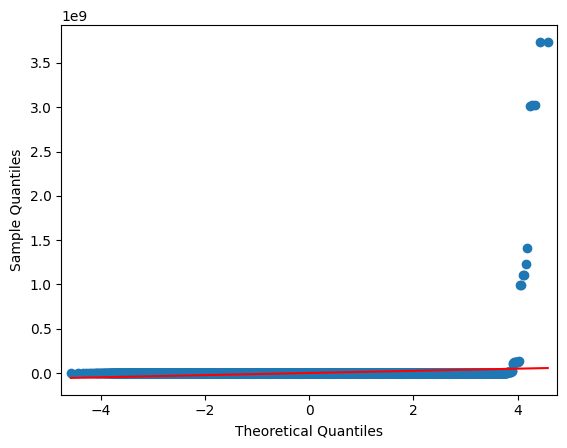

In [12]:
# visualizing normality with qqplot
from scipy.stats.distributions import norm
from statsmodels.graphics.gofplots import qqplot
qqplot(df['price'],line = 's',dist = norm)
plt.show()

Based on the visualized Q-Q plot, the distribution does not appear to be normal.

Non-linearity: The points do not follow a straight line, especially in the tails. This suggests that the distribution is not symmetric and has heavier tails than a normal distribution.

#Testing Normality of price

In [13]:
stat, p_value = shapiro(df['price'].dropna())
print("\nNormality Test for 'price':")
if p_value > 0.05:
    print(f"'price' is normally distributed (p-value = {p_value})")
    is_normal = True
else:
    print(f"'price' is NOT normally distributed (p-value = {p_value})")
    is_normal = False


Normality Test for 'price':
'price' is NOT normally distributed (p-value = 2.2347413560706543e-222)


/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 426880.
  res = hypotest_fun_out(*samples, **kwds)


#Hypothesis Testing

##Null hypothesis (): The distribution of 'price' for missing and non-missing data points is identical (i.e., no significant change).

##Alternative Hypothesis (): Missing and non-missing data points have different 'price' distributions (indicating a substantial difference).


In [14]:
results = {}
for col in df.columns:
    if col != 'price':
        missing_mask = df[col].isnull()
        # Separate 'price' for missing and non-missing data points
        price_missing = df.loc[missing_mask, 'price']
        price_non_missing = df.loc[~missing_mask, 'price']

        # Perform the appropriate statistical test
        if len(price_missing) > 1 and len(price_non_missing) > 1:
              if is_normal:
                  # Perform Independent Samples t-test
                  test_stat, p_value = ttest_ind(price_missing, price_non_missing, equal_var=False, nan_policy='omit')
              else:
                  # Perform Mann-Whitney U-test
                  test_stat, p_value = mannwhitneyu(price_missing, price_non_missing, alternative='two-sided')

              # Store the test results
              results[col] = {
                  'p_value': p_value,
                  'test_statistic': test_stat,
                  'significant': p_value < 0.05
              }

#Display the test results
print("\nStatistical Test Results for Missing vs. Non-Missing Data Impact on 'price':")
for feature, result in results.items():
  print('****************************************************************************************************************************************************')
  if result['p_value'] > 0.05:
      print(f" for {feature} with {result['p_value']}, the null hypothesis () is not rejected, indicating that missingness has no significant effect on 'price'")

  else:
     print(f" for {feature} with {result['p_value']}, reject the null hypothesis (), indicating that missingness has a substantial impact on 'price'")


Statistical Test Results for Missing vs. Non-Missing Data Impact on 'price':
****************************************************************************************************************************************************
 for year with 7.143240704129436e-264, reject the null hypothesis (), indicating that missingness has a substantial impact on 'price'
****************************************************************************************************************************************************
 for manufacturer with 1.1496127388818606e-23, reject the null hypothesis (), indicating that missingness has a substantial impact on 'price'
****************************************************************************************************************************************************
 for model with 5.7265343766695715e-83, reject the null hypothesis (), indicating that missingness has a substantial impact on 'price'
****************************************************************

#Missingness-based Imputation Strategy

##Use Mean Imputation for numerical data with missingness < 20%.

##Use K-Nearest Neighbors (KNN) or Iterative Imputer for missingness between 20% and 40%.

##For categorical data, use Mode Imputation or construct a "Unknown" category to account for missing values.

##If missingness is above 40% and there is no strong influence towards 'price' (as shown by p-values and correlation analysis), remove the feature.


In [15]:
df.dtypes

,0
price,int64
year,datetime64[ns]
manufacturer,object
model,object
condition,object
cylinders,object
fuel,object
odometer,float64
title_status,object
transmission,object


In [16]:
numerical_cols = df.select_dtypes(include=[np.number])
categorical_cols = df.select_dtypes('object')
date = df.select_dtypes(include =  'datetime64[ns]')
categorical_cols = pd.concat([categorical_cols,date],axis = 1)
categorical_cols['year'] = categorical_cols['year'].dt.year
categorical_cols

,manufacturer,model,condition,cylinders,fuel,title_status,transmission,drive,size,type,year
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
426875,nissan,maxima s sedan 4d,good,6 cylinders,gas,clean,other,fwd,NaN,sedan,1970.0
426876,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,clean,other,fwd,NaN,sedan,1970.0
426877,cadillac,xt4 sport suv 4d,good,NaN,diesel,clean,other,NaN,NaN,hatchback,1970.0
426878,lexus,es 350 sedan 4d,good,6 cylinders,gas,clean,other,fwd,NaN,sedan,1970.0


In [17]:
# Use Mean Imputation for numerical data with missingness < 20%.
missing_percentage = df.isnull().mean() * 100
for col in numerical_cols:
  if missing_percentage[col] < 20:
    df[col].fillna(df[col].mean(), inplace=True)
  elif  20 <= missing_percentage[col] <= 40:
    imp = iterativeimputer(max_iter = 10,random_state = 0)
    df[[col]] = imp.fit_transform(df[[col]])
  elif missing_percentage[col] > 40:
    correlation = df[col].corr(df['price'])
    if abs(correlation) <= 0.1:
            df.drop(columns=[col], inplace=True)
# for categorical column
for col in categorical_cols:
    if missing_percentage[col] < 40:
        mode_value = df[col].mode()[0]
        df[col].fillna(mode_value, inplace=True)
    else:
        df[col].fillna('Unknown', inplace=True)

<ipython-input-17-41e5ce544c20>:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mean(), inplace=True)
<ipython-input-17-41e5ce544c20>:17: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using '

In [18]:
df1 = df.copy()
df2 = df.copy()
df3 = df.copy()
df4 = df.copy()
df5 = df.copy()
df6 = df.copy()
df7 = df.copy()
df8 = df.copy()
df9 = df.copy()

In [19]:
df.isna().sum()

,0
price,0
year,0
manufacturer,0
model,0
condition,0
cylinders,0
fuel,0
odometer,0
title_status,0
transmission,0


#Section C: Outliers Treatment
##Analyze Outliers:
###Visualize outliers in the dataset using appropriate plots (e.g., boxplots, density plots, or histograms).

###(Optional – Will apply during modeling) Evaluate the effect of outliers on the target variable 'price': Do outliers have a substantial impact on 'price'? Explain with code and visuals.

###Use three alternative outlier treatment strategies for the 'price' variable and other relevant features:
###Capping or trimming method: Limit extreme values by using percentiles (for example, limiting at the 25th and 75th percentiles).

###Z-Score Method: Remove or transform data points with a Z-score greater than a specific threshold (e.g., ±3).
###z= (x-mean)/standard deviation

###Use log or square root transformation to mitigate the impact of extreme numbers.

###(Optional – Will apply during modeling) Evaluate each technique's effectiveness in improving data quality for modeling.


In [20]:
fig = px.box(df, x="manufacturer",
             y='price',
             notched=True,
             title="Box plot of price vs manufacturer",
            )
fig.update_layout(autosize = True,width =1500,height = 800)
fig.show()

In [21]:
fig = px.box(df, x="manufacturer",
             y='odometer',
             notched=True,
             title="Box plot of odometer and manufacturer",
            )
fig.show()

In [22]:
# Capping or trimming method: Limit extreme values by using percentiles (for example, limiting at the 25th and 75th percentiles).
q25 = df['price'].quantile(0.25)
q75 = df['price'].quantile(0.75)
iqr = q75 - q25
lower_bound = q25 - 1.5*iqr
upper_bound = q75 + 1.5*iqr
outliers = df1[(df1['price'] < lower_bound) | (df1['price'] > upper_bound)]
# removing outliers
df1_with_no_outliers = df1.drop(outliers.index.tolist())

zero_index = df1_with_no_outliers[df1_with_no_outliers['price'] == 0]

df1_with_no_outliers=df1_with_no_outliers.drop(zero_index.index.tolist())

fig = px.box(df1_with_no_outliers, x="manufacturer",
             y='price',
             title="Box plot of price",
            )
fig.show()

In [23]:
df1_with_no_outliers

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type
0,6000,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan
1,11900,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan
2,21000,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan
3,1500,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan
4,4900,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan
...,...,...,...,...,...,...,...,...,...,...,...,...,...
426875,23590,1970-01-01 00:00:00.000002019,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.000000,clean,other,fwd,Unknown,sedan
426876,30590,1970-01-01 00:00:00.000002020,volvo,s60 t5 momentum sedan 4d,good,Unknown,gas,12029.000000,clean,other,fwd,Unknown,sedan
426877,34990,1970-01-01 00:00:00.000002020,cadillac,xt4 sport suv 4d,good,Unknown,diesel,4174.000000,clean,other,4wd,Unknown,hatchback
426878,28990,1970-01-01 00:00:00.000002018,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.000000,clean,other,fwd,Unknown,sedan


In [24]:
q25 = df1_with_no_outliers['odometer'].quantile(0.25)
q75 = df1_with_no_outliers['odometer'].quantile(0.75)
iqr = q75 - q25
lower_bound = q25 - 1.5*iqr
upper_bound = q75 + 1.5*iqr
outliers = df1_with_no_outliers[(df1_with_no_outliers['odometer'] < lower_bound) | (df1_with_no_outliers['odometer'] > upper_bound)]
# removing outliers
df1_with_no_outliers = df1_with_no_outliers.drop(outliers.index.tolist())

zero_index = df1_with_no_outliers[df1_with_no_outliers['odometer'] == 0]

df1_with_no_outliers=df1_with_no_outliers.drop(zero_index.index.tolist())

fig = px.box(df1_with_no_outliers, x="manufacturer",
             y='odometer',
             title="Box plot of odometer",
            )
fig.show()

In [25]:
# impact of outliers on summary statistics
df1_with_no_outliers.describe()

,price,year,odometer
count,380947.000000,380947,380947.000000
mean,17815.433425,1970-01-01 00:00:00.000002011,92206.738809
min,1.000000,1970-01-01 00:00:00.000001900,1.000000
25%,7000.000000,1970-01-01 00:00:00.000002008,39650.000000
50%,14995.000000,1970-01-01 00:00:00.000002013,88733.000000
75%,26990.000000,1970-01-01 00:00:00.000002017,134721.000000
max,57341.000000,1970-01-01 00:00:00.000002022,280443.000000
std,12756.831961,NaN,60593.587597


In [26]:
df1.describe()

,price,year,odometer
count,4.268800e+05,426880,4.268800e+05
mean,7.519903e+04,1970-01-01 00:00:00.000002011,9.804333e+04
min,0.000000e+00,1970-01-01 00:00:00.000001900,0.000000e+00
25%,5.900000e+03,1970-01-01 00:00:00.000002008,3.813000e+04
50%,1.395000e+04,1970-01-01 00:00:00.000002014,8.660000e+04
75%,2.648575e+04,1970-01-01 00:00:00.000002017,1.330000e+05
max,3.736929e+09,1970-01-01 00:00:00.000002022,1.000000e+07
std,1.218228e+07,NaN,2.127764e+05


#From dataframes above which shows that summary statistics of each dataframes is significantly different , Though outliers are still present buh with further analysis they can be treated

In [27]:
# Z-Score Method: Remove or transform data points with a Z-score greater than a specific threshold (e.g., ±3)
z_scores = np.abs(stats.zscore(df2[['price', 'odometer']]))
threshold = 3
outliers = np.abs(z_scores) > threshold
df2_no_outliers = df2[~outliers.any(axis=1)]

In [28]:
# Use log or square root transformation to mitigate the impact of extreme numbers.
df2_no_outliers['logged_price'] = np.log(df2_no_outliers['price'] + 1)
df2_no_outliers['logged_odometer'] = np.log(df2_no_outliers['odometer'] + 1)
df2_no_outliers['sqred_price'] = np.sqrt(df2_no_outliers['price'])
df2_no_outliers['sqred_odometer'] = np.sqrt(df2_no_outliers['price'])

<ipython-input-28-b6f07debfb95>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-28-b6f07debfb95>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-28-b6f07debfb95>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-28-b6f07de

In [29]:
df2_no_outliers

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,logged_price,logged_odometer,sqred_price,sqred_odometer
0,6000,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan,8.699681,11.493175,77.459667,77.459667
1,11900,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan,9.384378,11.493175,109.087121,109.087121
2,21000,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan,9.952325,11.493175,144.913767,144.913767
3,1500,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan,7.313887,11.493175,38.729833,38.729833
4,4900,1970-01-01 00:00:00.000002017,ford,f-150,Unknown,Unknown,gas,98043.331443,clean,automatic,4wd,Unknown,sedan,8.497195,11.493175,70.000000,70.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426875,23590,1970-01-01 00:00:00.000002019,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.000000,clean,other,fwd,Unknown,sedan,10.068621,10.380560,153.590364,153.590364
426876,30590,1970-01-01 00:00:00.000002020,volvo,s60 t5 momentum sedan 4d,good,Unknown,gas,12029.000000,clean,other,fwd,Unknown,sedan,10.328461,9.395159,174.899971,174.899971
426877,34990,1970-01-01 00:00:00.000002020,cadillac,xt4 sport suv 4d,good,Unknown,diesel,4174.000000,clean,other,4wd,Unknown,hatchback,10.462846,8.336870,187.056141,187.056141
426878,28990,1970-01-01 00:00:00.000002018,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.000000,clean,other,fwd,Unknown,sedan,10.274741,10.312712,170.264500,170.264500


<Axes: >

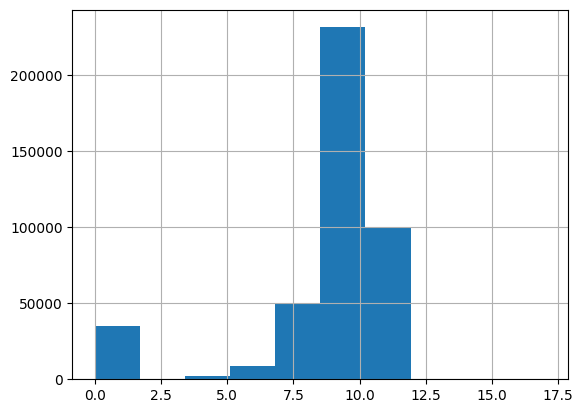

In [30]:
df2_no_outliers['logged_price'].hist()

In [31]:

df1_with_no_outliers['price'] = df1_with_no_outliers['price'].astype('float')
number = {}
for i in df1_with_no_outliers.columns:
  number[i] = df1_with_no_outliers[i].nunique()

unique = {}
for i in df1_with_no_outliers.columns:
  unique[i] = df1_with_no_outliers[i].unique()


In [32]:
cylinder_mapping = {'3 cylinders' : 1,
                    '4 cylinders' : 2,
                    '5 cylinders' : 3,
                    '6 cylinders' : 4,
                    '8 cylinders' : 5,
                   '10 cylinders': 6,
                    '12 cylinders': 7,
                    'Unknown' : 0,
                    'other': 0}

condition_mapping = {'salvage' : 1,
                     'Unknown': 2,
                     'fair': 3,
                     'good': 4,
                     'excellent': 5,
                     'like new' : 6,
                     'new': 7}

title_mapping = {'salvage':0,
                 'parts only': 1,
                 'lien': 2,
                 'missing' : 3,
                 'rebuilt': 4,
                 'clean': 5}

In [33]:
ordinal_categories = ['cylinders','condition','title_status']
numerical_cols = ['price','odometer','year']
object_cols=['transmission','drive','size','type','manufacturer','model']

#Frequency-based (Top N) binning to categorize unusual categories as "Other".
#Target mean binning to encode each category with its corresponding target variable mean value.

In [34]:
def frequency_based(data,col,number):
  category_count = data[col].value_counts()
  N=number
  top_categories = category_count.nlargest(N).index
  binned_type = data[col].apply(lambda x: x if x in top_categories else 'other')
  return binned_type

for col in object_cols:
  df[col] = frequency_based(df,col,5)

In [35]:
def target_mean_encoding(df,column,target):
  target_mean = df.groupby(column)[target].mean()
  encoded_column = df[column].map(target_mean)
  return encoded_column

for column in object_cols:
  df1_with_no_outliers[column] = target_mean_encoding(df1_with_no_outliers,column,'price')

#ordinal columns

In [36]:
df1_with_no_outliers['cylinder_mapping'] = df1_with_no_outliers['cylinders'].map(cylinder_mapping)
df1_with_no_outliers['title_mapping'] = df1_with_no_outliers['title_status'].map(title_mapping)
df1_with_no_outliers['condition_mapping'] = df1_with_no_outliers['condition'].map(condition_mapping)

#Object columns

In [37]:
fuel_dummies = pd.get_dummies(df1_with_no_outliers['fuel'],drop_first = True)
fuel_dummies = fuel_dummies.astype('int64')

In [38]:
df1_with_no_outliers  = pd.concat([df1_with_no_outliers,fuel_dummies],axis = 1)

In [39]:
df1_with_no_outliers.drop(['condition','cylinders','fuel','title_status'],axis = 1,inplace = True)

In [40]:
df1_with_no_outliers['year']=df1_with_no_outliers['year'].astype(int)

#Compare the outcomes of each scaling method for numerical variables.
##minmaxscaler
This is a data preprocessing technique used to normalize numerical features in a dataset to a specific range, typically between 0 and 1.

##standardscaler
This process transforms the data to have a mean of 0 and a standard deviation of 1, which is particularly useful for many machine learning algorithms that assume the data is normally distributed.


##binarizer
This can be useful for transforming continuous features into binary features(0,1), which can help in various machine learning algorithms, particularly in classification tasks.

##normalizer
This is particularly useful when you want to transform your data such that each sample (row) has a length of 1, while maintaining the direction of the data. Normalization can help improve the performance of some machine learning algorithms, especially those that are sensitive to the scale of the data.

In [41]:
# the dataset before numerical preprocessing
df1_with_no_outliers


,price,year,manufacturer,model,odometer,transmission,drive,size,type,cylinder_mapping,title_mapping,condition_mapping,electric,gas,hybrid,other
0,6000.0,2017,18903.343356,19370.385646,98043.331443,16083.626488,19568.203157,19400.932222,14213.283606,0,5,2,0,1,0,0
1,11900.0,2017,18903.343356,19370.385646,98043.331443,16083.626488,19568.203157,19400.932222,14213.283606,0,5,2,0,1,0,0
2,21000.0,2017,18903.343356,19370.385646,98043.331443,16083.626488,19568.203157,19400.932222,14213.283606,0,5,2,0,1,0,0
3,1500.0,2017,18903.343356,19370.385646,98043.331443,16083.626488,19568.203157,19400.932222,14213.283606,0,5,2,0,1,0,0
4,4900.0,2017,18903.343356,19370.385646,98043.331443,16083.626488,19568.203157,19400.932222,14213.283606,0,5,2,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426875,23590.0,2019,12784.122754,23979.681818,32226.000000,27886.798738,12458.011305,19400.932222,14213.283606,4,5,4,0,1,0,0
426876,30590.0,2020,17476.722845,29800.909091,12029.000000,27886.798738,12458.011305,19400.932222,14213.283606,0,5,4,0,1,0,0
426877,34990.0,2020,19630.805059,34566.344086,4174.000000,27886.798738,19568.203157,19400.932222,14989.399319,0,5,4,0,0,0,0
426878,28990.0,2018,20190.696496,24360.333333,30112.000000,27886.798738,12458.011305,19400.932222,14213.283606,4,5,4,0,1,0,0


In [42]:
minmax = MinMaxScaler(feature_range=(0, 1))
norm = Normalizer()
binarizer = Binarizer()
standardscaler = StandardScaler()

In [43]:
target = df1_with_no_outliers['price']

In [44]:
numerical_df = df1_with_no_outliers[['year','manufacturer','model','odometer','transmission','drive','size','type']]
encoded_cols = df1_with_no_outliers[['cylinder_mapping','title_mapping','condition_mapping','electric','gas','hybrid','other']]
minmaxed = minmax.fit_transform(numerical_df)
standardscaler =standardscaler.fit_transform(numerical_df)
binarizer = binarizer.fit_transform(numerical_df)
normalizer = norm.fit_transform(numerical_df)

In [45]:
minmaxed_df = pd.DataFrame(minmaxed,columns=numerical_df.columns)
minmaxed_df.reset_index(drop=True, inplace=True)
encoded_cols.reset_index(drop=True, inplace=True)

minmaxed_df = pd.concat([minmaxed_df,encoded_cols],axis = 1)
minmaxed_df

,year,manufacturer,model,odometer,transmission,drive,size,type,cylinder_mapping,title_mapping,condition_mapping,electric,gas,hybrid,other
0,0.959016,0.447842,0.339820,0.349599,0.187301,0.949084,1.0,0.257852,0,5,2,0,1,0,0
1,0.959016,0.447842,0.339820,0.349599,0.187301,0.949084,1.0,0.257852,0,5,2,0,1,0,0
2,0.959016,0.447842,0.339820,0.349599,0.187301,0.949084,1.0,0.257852,0,5,2,0,1,0,0
3,0.959016,0.447842,0.339820,0.349599,0.187301,0.949084,1.0,0.257852,0,5,2,0,1,0,0
4,0.959016,0.447842,0.339820,0.349599,0.187301,0.949084,1.0,0.257852,0,5,2,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380942,0.975410,0.248647,0.420686,0.114908,1.000000,0.000000,1.0,0.257852,4,5,4,0,1,0,0
380943,0.983607,0.401402,0.522815,0.042889,1.000000,0.000000,1.0,0.257852,0,5,4,0,1,0,0
380944,0.983607,0.471523,0.606420,0.014880,1.000000,0.949084,1.0,0.302379,0,5,4,0,0,0,0
380945,0.967213,0.489749,0.427364,0.107370,1.000000,0.000000,1.0,0.257852,4,5,4,0,1,0,0


In [46]:
standardscaler_df =pd.DataFrame(standardscaler,columns=numerical_df.columns)
standardscaler_df.reset_index(drop=True, inplace=True)
encoded_cols.reset_index(drop=True, inplace=True)

standardscaler_df = pd.concat([standardscaler_df,encoded_cols],axis = 1)
standardscaler_df

,year,manufacturer,model,odometer,transmission,drive,size,type,cylinder_mapping,title_mapping,condition_mapping,electric,gas,hybrid,other
0,0.633921,0.262784,0.155775,0.096324,-0.389726,0.560178,0.577118,-0.750589,0,5,2,0,1,0,0
1,0.633921,0.262784,0.155775,0.096324,-0.389726,0.560178,0.577118,-0.750589,0,5,2,0,1,0,0
2,0.633921,0.262784,0.155775,0.096324,-0.389726,0.560178,0.577118,-0.750589,0,5,2,0,1,0,0
3,0.633921,0.262784,0.155775,0.096324,-0.389726,0.560178,0.577118,-0.750589,0,5,2,0,1,0,0
4,0.633921,0.262784,0.155775,0.096324,-0.389726,0.560178,0.577118,-0.750589,0,5,2,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380942,0.847484,-1.215312,0.617535,-0.989887,2.266461,-1.712209,0.577118,-0.750589,4,5,4,0,1,0,0
380943,0.954266,-0.081815,1.200707,-1.323207,2.266461,-1.712209,0.577118,-0.750589,0,5,4,0,1,0,0
380944,0.954266,0.438503,1.678109,-1.452841,2.266461,0.560178,0.577118,-0.588868,0,5,4,0,0,0,0
380945,0.740703,0.573744,0.655669,-1.024775,2.266461,-1.712209,0.577118,-0.750589,4,5,4,0,1,0,0


In [47]:
binarized_df = pd.DataFrame(binarizer,columns=numerical_df.columns)
binarized_df.reset_index(drop=True, inplace=True)
encoded_cols.reset_index(drop=True, inplace=True)

binarized_df = pd.concat([binarized_df,encoded_cols],axis = 1)
binarized_df

,year,manufacturer,model,odometer,transmission,drive,size,type,cylinder_mapping,title_mapping,condition_mapping,electric,gas,hybrid,other
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380942,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4,5,4,0,1,0,0
380943,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,4,0,1,0,0
380944,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,4,0,0,0,0
380945,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4,5,4,0,1,0,0


In [48]:
normalized_df = pd.DataFrame(minmaxed,columns=numerical_df.columns)
normalized_df.reset_index(drop=True, inplace=True)
encoded_cols.reset_index(drop=True, inplace=True)

normalized_df = pd.concat([normalized_df,encoded_cols],axis = 1)
binarized_df

,year,manufacturer,model,odometer,transmission,drive,size,type,cylinder_mapping,title_mapping,condition_mapping,electric,gas,hybrid,other
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,2,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380942,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4,5,4,0,1,0,0
380943,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,4,0,1,0,0
380944,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,5,4,0,0,0,0
380945,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4,5,4,0,1,0,0
